<a href="https://colab.research.google.com/github/digs1998/Netflix-Data-Wrangling-and-Sentiment-Analysis/blob/main/DW.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import nltk
from nltk.corpus import stopwords
import numpy as np
import math
import re
from tqdm import tqdm
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.linear_model import LogisticRegression
from sklearn.multiclass import OneVsRestClassifier
import tensorflow as tf
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from sklearn.metrics import f1_score
from wordcloud import WordCloud, ImageColorGenerator
from imblearn.over_sampling import SMOTE
from PIL import Image
drive.mount('/content/drive')

MessageError: ignored

# Data processing

In [ ]:
def freq_words(x, terms = 30):
  all_words = ' '.join([text for text in x])
  all_words = all_words.split()
  
  fdist = nltk.FreqDist(all_words)
  words_df = pd.DataFrame({'word':list(fdist.keys()), 'count':list(fdist.values())})
  
  # selecting top 20 most frequent words
  d = words_df.nlargest(columns="count", n = terms) 
  plt.figure(figsize=(12,15))
  ax = sns.barplot(data=d, x= "count", y = "word")
  ax.set(ylabel = 'Word')
  plt.show()

# function for text cleaning
def clean_text(text):
    # remove backslash-apostrophe
    text = re.sub("\'", "", text)
    # remove everything alphabets
    text = re.sub("[^a-zA-Z]"," ",text)
    # remove whitespaces
    text = ' '.join(text.split())
    text = text.lower()   
    return text

def remove_stopwords(text):
    no_stopword_text = [w for w in text.split() if not w in stop_words]
    return ' '.join(no_stopword_text)

def plot_hist (gen):
  all_genre_df = pd.DataFrame({"Genre":  gen.value_counts().index.to_list(),
              "Count":list(gen.value_counts())  
  })
  g = all_genre_df.nlargest(columns="Count", n = 50) 
  plt.figure(figsize=(12,15))
  ax = sns.barplot(data=g, x= "Count", y = "Genre")
  ax.set(ylabel = 'Genre Types')
  plt.show()

In [ ]:
# read in print head
df = pd.read_csv("/content/drive/MyDrive/Wrangling Project/Genre.csv")

# create necessary variables

# Concate genres
GN = []
for i in range(len(df["Genre 1"])):
  current_list = []
  current_list.append(df["Genre 1"][i])
  if not pd.isna(df["Genre 2"][i]): 
    current_list.append(df["Genre 2"][i])
  if not pd.isna(df["Genre 3"][i]): 
    current_list.append(df["Genre 3"][i])
  GN.append(current_list)
new = df[["Type","Description"]]
new["Genre"] = GN

# Indicator variables for Thriller, Comedies and Other
Thriller_list = ['Crime TV Shows', 'Thrillers', 'TV Horror', 'TV Thrillers']
Comedies_list = ['Comedies','TV Comedies', 'Anime Series','Stand-Up Comedy & Talk Shows']
Thriller_commedies = []
for i in range(len(new["Genre"])):
  if any(item in new["Genre"][i] for item in Thriller_list): 
    Thriller_commedies.append("Thriller")
  elif any(item in new["Genre"][i] for item in Comedies_list):
    Thriller_commedies.append("Comedies")
  else:
    Thriller_commedies.append("Others")
new["TC"] = Thriller_commedies

# Indicator for international or not
Internation = []
for i in range(len(new["Genre"])):
  if "International TV Shows" in new["Genre"][i]: 
    Internation.append("Yes")
  else:
    Internation.append("No")
new["internation"] = Internation

# New variables for countries
Country_new = []
for i in range(len(df['Country'])):
  current_list = []
  if pd.isna(df["Country"][i]):
    current_list.append("Missing")
  else:
    total_countries = df["Country"][i].split(',') 
    for i in range(len(total_countries)):
      current_list.append(total_countries[i].lstrip())
  Country_new.append(current_list)

new["Country_new"] = Country_new
new["year"] = df["Release_year"]
new.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stab

,Type,Description,Genre,TC,internation,Country_new,year
0,Movie,"As her father nears the end of his life, filmm...",[Documentaries],Others,No,[United States],2020
1,TV Show,"After crossing paths at a party, a Cape Town t...","[International TV Shows, TV Dramas, TV Mysteries]",Others,Yes,[South Africa],2021
2,TV Show,To protect his family from a powerful drug lor...,"[Crime TV Shows, International TV Shows, TV Ac...",Thriller,Yes,[Missing],2021
3,TV Show,"Feuds, flirtations and toilet talk go down amo...","[Docuseries, Reality TV]",Others,No,[Missing],2021
4,TV Show,In a city of coaching centers known to train I...,"[International TV Shows, Romantic TV Shows, TV...",Comedies,Yes,[India],2021


# Inital Genre Analysis

In [ ]:
# wide format to long format
new_df = new.explode('Country_new').explode('Genre')
new_df.to_csv("/content/drive/MyDrive/Wrangling Project/baseline.csv")

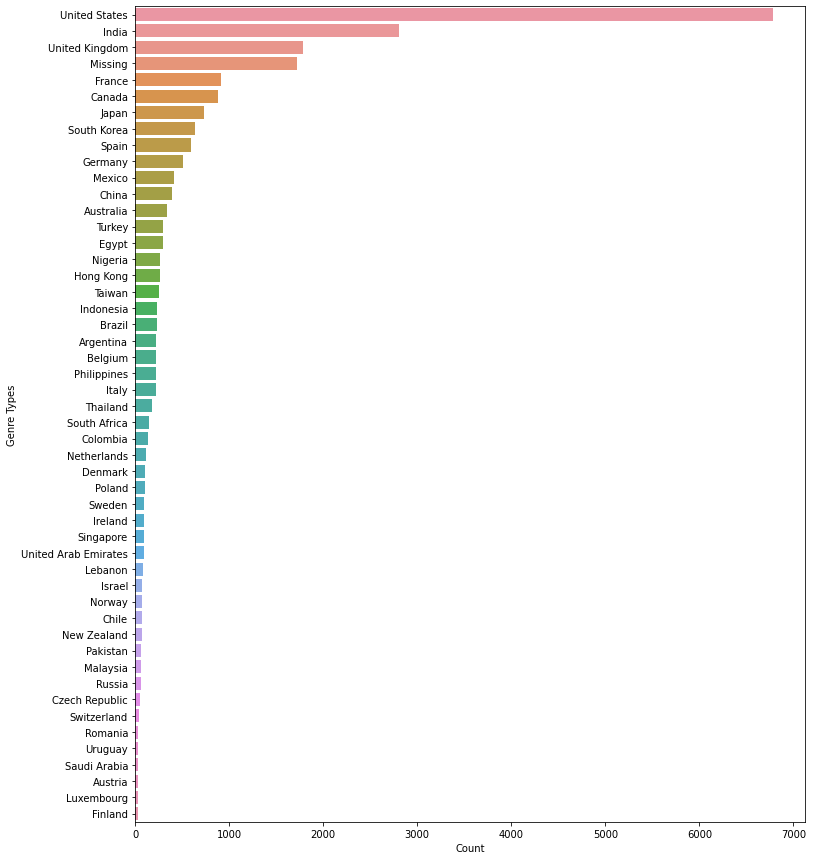

In [ ]:
plot_hist(new_df["Country_new"])

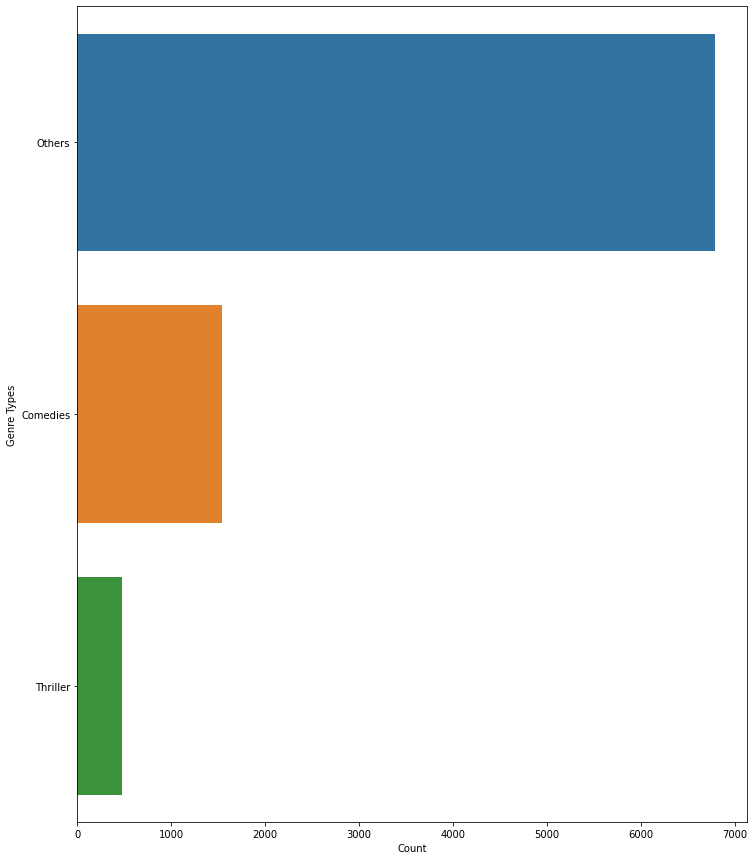

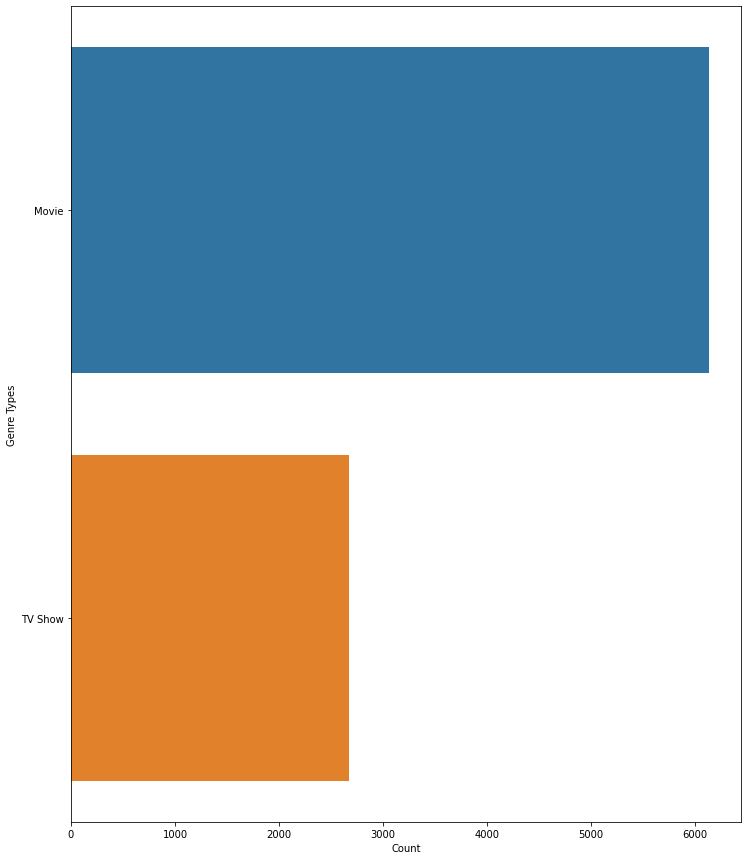

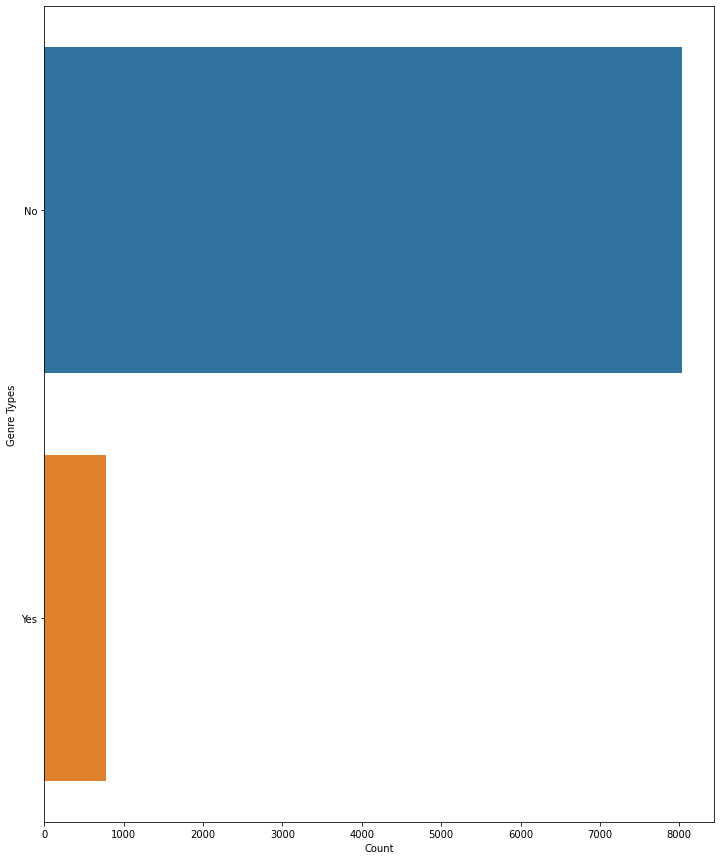

In [ ]:
plot_hist(new["TC"])
plot_hist(new["Type"])
plot_hist(new["internation"])

In [ ]:
new['clean_descrip'] = new['Description'].apply(lambda x: clean_text(x))
new[['Description', 'clean_descrip']].sample(3)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,Description,clean_descrip
984,The uneventful life of middle-aged Kudret turn...,the uneventful life of middle aged kudret turn...
7192,"After a skilled fighter falls in the ring, his...",after a skilled fighter falls in the ring his ...
5951,Laurie and Joseph are doctors who interview se...,laurie and joseph are doctors who interview se...


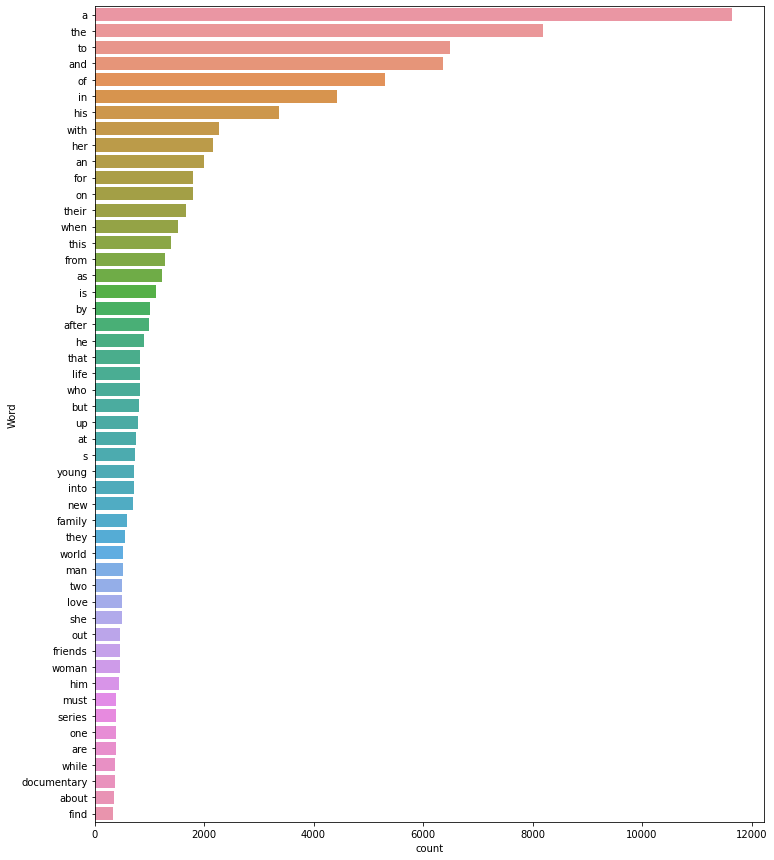

In [ ]:
freq_words(new['clean_descrip'], 50)

## remove stop words

In [ ]:
nltk.download('stopwords')
stop_words = set(stopwords.words('english'))
new['clean_descrip'] = new['clean_descrip'].apply(lambda x: remove_stopwords(x))

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


## Fit the model

## word embedding for genre

In [ ]:
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Embedding, GlobalAveragePooling1D
from tensorflow.keras.layers import TextVectorization

In [ ]:
# change internation to 0 and 1
new['internation_binary'] = 0
new.loc[new['internation'] == 'Yes', 'internation_binary'] = 1
new.loc[new['internation'] == 'No', 'internation_binary'] = 0
# change type to 0 and 1
new['Ismovie'] = 0
new.loc[new['Type'] == 'Movie', 'Ismovie'] = 1
new.loc[new['Type'] == 'TV Show', 'Ismovie'] = 0
# change TC to 0, 1, 2
new['TC_new']  = 0
new.loc[new['TC'] == 'Others', 'TC_new'] = 0
new.loc[new['TC'] == 'Thriller', 'TC_new'] = 1
new.loc[new['TC'] == 'Comedies', 'TC_new'] = 2

new.head()

,Type,Description,Genre,TC,internation,Country_new,year,clean_descrip,internation_binary,Ismovie,TC_new
0,Movie,"As her father nears the end of his life, filmm...",[Documentaries],Others,No,[United States],2020,father nears end life filmmaker kirsten johnso...,0,1,0
1,TV Show,"After crossing paths at a party, a Cape Town t...","[International TV Shows, TV Dramas, TV Mysteries]",Others,Yes,[South Africa],2021,crossing paths party cape town teen sets prove...,1,0,0
2,TV Show,To protect his family from a powerful drug lor...,"[Crime TV Shows, International TV Shows, TV Ac...",Thriller,Yes,[Missing],2021,protect family powerful drug lord skilled thie...,1,0,1
3,TV Show,"Feuds, flirtations and toilet talk go down amo...","[Docuseries, Reality TV]",Others,No,[Missing],2021,feuds flirtations toilet talk go among incarce...,0,0,0
4,TV Show,In a city of coaching centers known to train I...,"[International TV Shows, Romantic TV Shows, TV...",Comedies,Yes,[India],2021,city coaching centers known train india finest...,1,0,2


## Model 1: International

In [ ]:
# hyperparameters
vocab_size = 10000
max_length = 20
trunc_type='post'
oov_tok = ""

In [ ]:
X = new['clean_descrip']
y = new['internation_binary']
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

In [ ]:
tokenizer = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\\]^_`{|}~\t\n', split=" ")
tokenizer.fit_on_texts(X_train)
x_train = tokenizer.texts_to_sequences(X_train)
x_test = tokenizer.texts_to_sequences(X_test)
x_train = pad_sequences(x_train,maxlen=max_length, padding= trunc_type) 
x_test = pad_sequences(x_test,maxlen=max_length, padding= trunc_type)  

In [ ]:
n_feat = len(tokenizer.word_index)+1
n_feat

17146

In [ ]:
# Hyperparameters
embedding_dim = 64
lstm1_dim = 64
lstm2_dim = 32
dense_dim = 64

# Build the model
model1 = tf.keras.Sequential([
    tf.keras.layers.Embedding(input_dim=n_feat, output_dim = embedding_dim),
    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(lstm1_dim, return_sequences=True)),
    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(lstm2_dim)),
    tf.keras.layers.Dense(dense_dim, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid')
])

model1.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
NUM_EPOCHS = 5

# Train the model
history = model1.fit(x_train, y_train, epochs=NUM_EPOCHS, validation_data=(x_test, y_test))

Epoch 1/5
221/221 [==============================] - 28s 84ms/step - loss: 0.4274 - accuracy: 0.8450 - val_loss: 0.4104 - val_accuracy: 0.8388
Epoch 2/5
221/221 [==============================] - 15s 67ms/step - loss: 0.2191 - accuracy: 0.9121 - val_loss: 0.4870 - val_accuracy: 0.8184
Epoch 3/5
221/221 [==============================] - 20s 90ms/step - loss: 0.0521 - accuracy: 0.9824 - val_loss: 0.8169 - val_accuracy: 0.8144
Epoch 4/5
221/221 [==============================] - 16s 72ms/step - loss: 0.0082 - accuracy: 0.9972 - val_loss: 0.9797 - val_accuracy: 0.8178
Epoch 5/5
221/221 [==============================] - 16s 72ms/step - loss: 0.0012 - accuracy: 0.9999 - val_loss: 1.3094 - val_accuracy: 0.8207


In [ ]:
model1.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
NUM_EPOCHS = 5

# Train the model
history = model1.fit(x_train, y_train, epochs=NUM_EPOCHS, validation_data=(x_test, y_test))

Epoch 1/5
221/221 [==============================] - 20s 46ms/step - loss: 3.6134e-06 - accuracy: 1.0000 - val_loss: 1.6742 - val_accuracy: 0.8808
Epoch 2/5
221/221 [==============================] - 8s 37ms/step - loss: 4.9180e-08 - accuracy: 1.0000 - val_loss: 1.7096 - val_accuracy: 0.8820
Epoch 3/5
221/221 [==============================] - 8s 38ms/step - loss: 2.6900e-08 - accuracy: 1.0000 - val_loss: 1.7359 - val_accuracy: 0.8814
Epoch 4/5
221/221 [==============================] - 8s 38ms/step - loss: 1.8193e-08 - accuracy: 1.0000 - val_loss: 1.7599 - val_accuracy: 0.8808
Epoch 5/5
221/221 [==============================] - 8s 38ms/step - loss: 1.3394e-08 - accuracy: 1.0000 - val_loss: 1.7820 - val_accuracy: 0.8802


In [ ]:
# check one prediction
new_complaint = ['Great Brazilian Dude is working on a project']
seq = tokenizer.texts_to_sequences(new_complaint)
padded = pad_sequences(seq, maxlen=max_length, padding= trunc_type)
pred = model1.predict(padded)
pred
labels = ["Domestic", "International"]
print(pred, labels[np.argmax(pred)])

1/1 [==============================] - 7s 7s/step
[[2.6486e-08]] Domestic


In [ ]:
wordindex_dict = tokenizer.word_index

# number of unique words
words = len(wordindex_dict)

In [ ]:
from tensorboard.plugins import projector
%load_ext tensorboard

# create logging directory
log_dir='/logs/fit/'
if not os.path.exists(log_dir):
    os.makedirs(log_dir)

# write wordindex dictionary
with open(os.path.join(log_dir, 'metadata.tsv'), "w") as f:
  for w in wordindex_dict:
    f.write("{}\n".format(w))

# weights from the embedding layer, in our case: model.layers[1]
weights = tf.Variable(model1.layers[0].get_weights()[0][1:])
checkpoint = tf.train.Checkpoint(embedding=weights)
checkpoint.save(os.path.join(log_dir, "embedding.ckpt"))

# configuration set-up
config = projector.ProjectorConfig()
embedding = config.embeddings.add()
embedding.tensor_name = "embedding/.ATTRIBUTES/VARIABLE_VALUE"
embedding.metadata_path = 'metadata.tsv'
projector.visualize_embeddings(log_dir, config)
%tensorboard --logdir /logs/fit/

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 792), started 0:02:19 ago. (Use '!kill 792' to kill it.)

<IPython.core.display.Javascript object>

## Genre preidction

In [ ]:
X = new['clean_descrip']
y = new['TC_new']
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)
tokenizer = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\\]^_`{|}~\t\n', split=" ")
tokenizer.fit_on_texts(X_train)
x_train = tokenizer.texts_to_sequences(X_train)
x_test = tokenizer.texts_to_sequences(X_test)
x_train = pad_sequences(x_train,maxlen=max_length, padding= trunc_type) 
x_test = pad_sequences(x_test,maxlen=max_length, padding= trunc_type)  
sm = SMOTE()
x_train, y_train = sm.fit_resample(x_train, y_train)
y_train = pd.get_dummies(y_train)
y_test = pd.get_dummies(y_test)
n_feat = len(tokenizer.word_index)+1
n_feat

17146

In [ ]:
# Hyperparameters
embedding_dim = 64
lstm1_dim = 64
lstm2_dim = 32
dense_dim = 64
# check word embedding
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir="logs")
# Build the model
model2 = tf.keras.Sequential([
    tf.keras.layers.Embedding(input_dim=n_feat, output_dim = embedding_dim),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(lstm1_dim, return_sequences=True)),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(lstm2_dim)),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(dense_dim, activation='relu'),
    tf.keras.layers.Dense(3, activation='sigmoid')
])

model2.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
NUM_EPOCHS = 5

# Train the model
history = model2.fit(x_train, y_train, epochs=NUM_EPOCHS, validation_data=(x_test, y_test), callbacks=[tensorboard_callback])

Epoch 1/5
397/397 [==============================] - 50s 98ms/step - loss: 0.6257 - accuracy: 0.3926 - val_loss: 0.5621 - val_accuracy: 0.5358
Epoch 2/5
397/397 [==============================] - 33s 82ms/step - loss: 0.5220 - accuracy: 0.5986 - val_loss: 0.5315 - val_accuracy: 0.5863
Epoch 3/5
397/397 [==============================] - 32s 79ms/step - loss: 0.3571 - accuracy: 0.7654 - val_loss: 0.6301 - val_accuracy: 0.5562
Epoch 4/5
397/397 [==============================] - 26s 65ms/step - loss: 0.2149 - accuracy: 0.8730 - val_loss: 0.8067 - val_accuracy: 0.5482
Epoch 5/5
397/397 [==============================] - 25s 64ms/step - loss: 0.1353 - accuracy: 0.9268 - val_loss: 0.9106 - val_accuracy: 0.5420


In [ ]:
# check one prediction
new_complaint = ['Thriller Thrieller Thrieller']
seq = tokenizer.texts_to_sequences(new_complaint)
padded = pad_sequences(seq, maxlen=max_length, padding= trunc_type)
pred = model2.predict(padded)
pred
#labels = ["Domestic", "International"]
#print(pred, labels[np.argmax(pred)])

1/1 [==============================] - 2s 2s/step


array([[9.9793035e-01, 5.2253448e-04, 1.7759096e-03]], dtype=float32)

In [ ]:
word_list = []
for word, i in tokenizer.word_index.items():
    word_list.append(word)

In [ ]:
tokenizer = new['clean_descrip'].encoder

# Hyperparameters
embedding_dim = 64
filters = 128
kernel_size = 5
dense_dim = 64

# Build the model
model = tf.keras.Sequential([
    tf.keras.layers.Embedding(tokenizer.vocab_size, embedding_dim),
    tf.keras.layers.Conv1D(filters=filters, kernel_size=kernel_size, activation='relu'),
    tf.keras.layers.GlobalMaxPooling1D(),
    tf.keras.layers.Dense(dense_dim, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid')
])

# Print the model summary
model.summary()

AttributeError: ignored

In [ ]:
# one hot encode the outcome due to the various genres
multilabel_binarizer = MultiLabelBinarizer()
multilabel_binarizer.fit(new['Genre'])
y = multilabel_binarizer.transform(new['Genre'])
y

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [ ]:
# The maximum number of words to be used. (most frequent)
MAX_NB_WORDS = 50000
MAX_SEQUENCE_LENGTH = 40
# This is fixed.
EMBEDDING_DIM = 100
tokenizer = Tokenizer(num_words=MAX_NB_WORDS)
tokenizer.fit_on_texts(new['clean_descrip'])
word_index = tokenizer.word_index
print('Found %s unique tokens.' % len(word_index))

Found 19183 unique tokens.


In [ ]:
X = tokenizer.texts_to_sequences(new['clean_descrip'])
X = pad_sequences(X, maxlen=MAX_SEQUENCE_LENGTH)
print('Shape of data tensor:', X.shape)

Shape of data tensor: (8807, 40)


In [ ]:
# test train split
X_train, X_test, Y_train, Y_test = train_test_split(X,y, test_size = 0.10, random_state = 42)
print(X_train.shape,Y_train.shape)
print(X_test.shape,Y_test.shape)

(7926, 40) (7926, 73)
(881, 40) (881, 73)


In [ ]:
model = tf.keras.Sequential()
model.add(tf.keras.layers.Embedding(MAX_NB_WORDS, EMBEDDING_DIM, input_length=X.shape[1]))
model.add(tf.keras.layers.LSTM(100))
model.add(tf.keras.layers.Dense(73, activation='softmax'))
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

epochs = 5

history = model.fit(X_train, Y_train, epochs=epochs, validation_split=0.1)

Epoch 1/5
223/223 [==============================] - 24s 96ms/step - loss: 8.5899 - accuracy: 0.1949 - val_loss: 8.8059 - val_accuracy: 0.1854
Epoch 2/5
223/223 [==============================] - 20s 92ms/step - loss: 9.5598 - accuracy: 0.1973 - val_loss: 9.5484 - val_accuracy: 0.1854
Epoch 3/5
223/223 [==============================] - 23s 104ms/step - loss: 10.4277 - accuracy: 0.1973 - val_loss: 10.3601 - val_accuracy: 0.1854
Epoch 4/5
223/223 [==============================] - 21s 95ms/step - loss: 11.4011 - accuracy: 0.1973 - val_loss: 11.1760 - val_accuracy: 0.1854
Epoch 5/5
223/223 [==============================] - 22s 99ms/step - loss: 12.2709 - accuracy: 0.1973 - val_loss: 12.0055 - val_accuracy: 0.1854


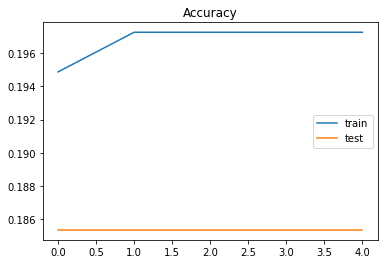

In [ ]:
plt.title('Accuracy')
plt.plot(history.history['accuracy'], label='train')
plt.plot(history.history['val_accuracy'], label='test')
plt.legend()
plt.show()

In [ ]:
word_embds = model.layers[0].get_weights()
X_embedded = TSNE(n_components=2).fit_transform(word_weights)

NameError: ignored

In [ ]:
# check one prediction
new_complaint = ['jumanji']
seq = tokenizer.texts_to_sequences(new_complaint)
padded = pad_sequences(seq, maxlen=MAX_SEQUENCE_LENGTH)
pred = model.predict(padded)
labels = genres['Genre'].unique().tolist()
print(pred, labels[np.argmax(pred)])

1/1 [==============================] - 0s 40ms/step
[[2.4855078e-16 5.6705302e-17 4.1705246e-27 2.9060178e-17 1.4938199e-02
  7.2982224e-13 4.6907085e-13 6.5168637e-17 6.7285739e-04 4.3139782e-02
  2.6387403e-11 1.3944872e-10 4.4335324e-02 2.3445490e-01 3.5941385e-02
  4.5061432e-13 9.4119110e-05 1.1530635e-08 1.3981628e-02 2.0215466e-06
  3.9944984e-02 1.1124273e-02 4.0508281e-03 1.5460973e-09 3.9524780e-04
  3.0674222e-03 1.7624666e-26 2.9370162e-21 1.0693761e-06 1.3840790e-02
  4.4629216e-02 3.7685008e-13 1.9163341e-08 2.6616005e-09 1.6050738e-12
  8.7576535e-12 2.5093235e-02 5.3347390e-02 7.3717811e-21 1.0854104e-03
  6.8150894e-03 2.4944924e-02 3.6754620e-22 1.4331165e-10 7.0991568e-02
  2.0071201e-02 1.5466967e-27 5.2856367e-02 3.6632495e-03 1.5308507e-01
  5.4693138e-03 7.6900085e-22 9.2605114e-06 5.1426340e-02 1.1632550e-02
  2.3999811e-33 1.0232198e-14 7.8165932e-22 2.4882147e-06 2.9128020e-30
  2.4365866e-17 4.2406984e-26 3.6586689e-33 9.2903528e-33 1.4889272e-02
  1.7148890e

# Experiments Code


In [ ]:
# check movie types
df["Type"].unique()

# seperate by 2 values
genres = pd.concat([df["Genre 1"], df["Genre 2"], df["Genre 3"]], ignore_index = True).to_frame(name = "Genre")
types = pd.concat([df["Type"], df["Type"], df["Type"]], ignore_index = True).to_frame(name = "Types")
g_t = pd.concat([genres,types], axis = 1)

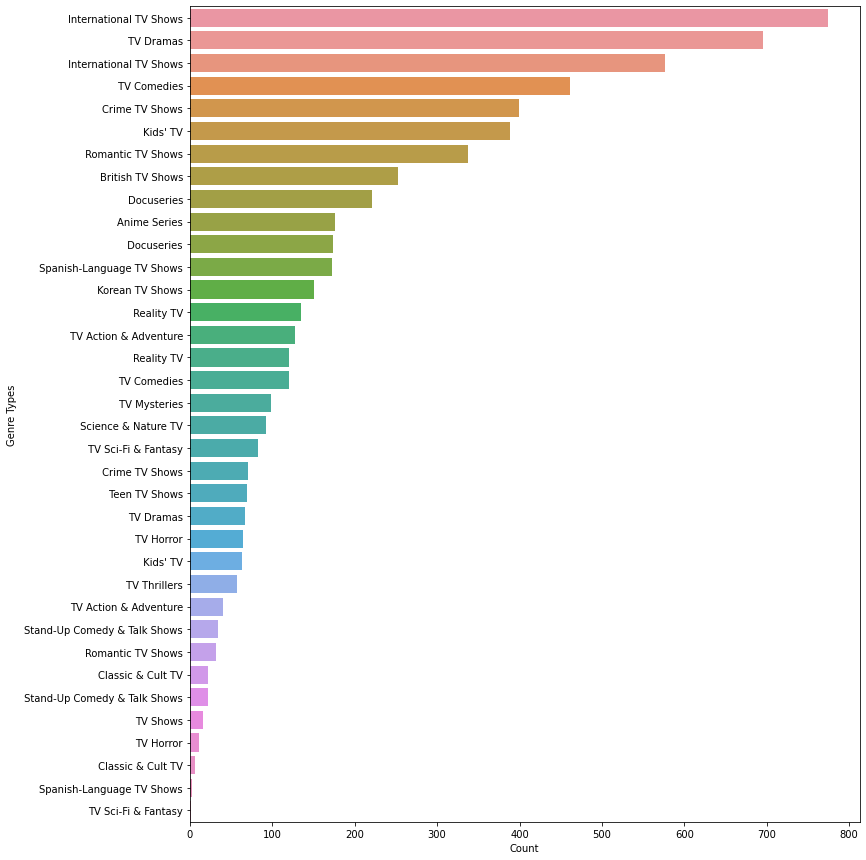

In [ ]:
plot_hist(g_t[g_t["Types"] == 'TV Show']["Genre"])

# Projector

In [ ]:
def freq_words(x, terms = 30):
  all_words = ' '.join([text for text in x])
  all_words = all_words.split()
  
  fdist = nltk.FreqDist(all_words)
  words_df = pd.DataFrame({'word':list(fdist.keys()), 'count':list(fdist.values())})
  
  # selecting top 20 most frequent words
  d = words_df.nlargest(columns="count", n = terms) 
  plt.figure(figsize=(12,15))
  ax = sns.barplot(data=d, x= "count", y = "word")
  ax.set(ylabel = 'Word')
  plt.show()

# function for text cleaning
def clean_text(text):
    # remove backslash-apostrophe
    text = re.sub("\'", "", text)
    # remove everything alphabets
    text = re.sub("[^a-zA-Z]"," ",text)
    # remove whitespaces
    text = ' '.join(text.split())
    text = text.lower()   
    return text

def remove_stopwords(text):
    no_stopword_text = [w for w in text.split() if not w in stop_words]
    return ' '.join(no_stopword_text)

def plot_hist (gen):
  all_genre_df = pd.DataFrame({"Genre":  gen.value_counts().index.to_list(),
              "Count":list(gen.value_counts())  
  })
  g = all_genre_df.nlargest(columns="Count", n = 50) 
  plt.figure(figsize=(12,15))
  ax = sns.barplot(data=g, x= "Count", y = "Genre")
  ax.set(ylabel = 'Genre Types')
  plt.show()

# read in print head
df = pd.read_csv("/content/drive/MyDrive/Wrangling Project/Genre.csv")

# create necessary variables

# Concate genres
GN = []
for i in range(len(df["Genre 1"])):
  current_list = []
  current_list.append(df["Genre 1"][i])
  if not pd.isna(df["Genre 2"][i]): 
    current_list.append(df["Genre 2"][i])
  if not pd.isna(df["Genre 3"][i]): 
    current_list.append(df["Genre 3"][i])
  GN.append(current_list)
new = df[["Type","Description"]]
new["Genre"] = GN

# Indicator variables for Thriller, Comedies and Other
Thriller_list = ['Crime TV Shows', 'Thrillers', 'TV Horror', 'TV Thrillers']
Comedies_list = ['Comedies','TV Comedies', 'Anime Series','Stand-Up Comedy & Talk Shows']
Thriller_commedies = []
for i in range(len(new["Genre"])):
  if any(item in new["Genre"][i] for item in Thriller_list): 
    Thriller_commedies.append("Thriller")
  elif any(item in new["Genre"][i] for item in Comedies_list):
    Thriller_commedies.append("Comedies")
  else:
    Thriller_commedies.append("Others")
new["TC"] = Thriller_commedies

# Indicator for international or not
Internation = []
for i in range(len(new["Genre"])):
  if "International TV Shows" in new["Genre"][i]: 
    Internation.append("Yes")
  else:
    Internation.append("No")
new["internation"] = Internation

# New variables for countries
Country_new = []
for i in range(len(df['Country'])):
  current_list = []
  if pd.isna(df["Country"][i]):
    current_list.append("Missing")
  else:
    total_countries = df["Country"][i].split(',') 
    for i in range(len(total_countries)):
      current_list.append(total_countries[i].lstrip())
  Country_new.append(current_list)

new["Country_new"] = Country_new
new["year"] = df["Release_year"]

new['clean_descrip'] = new['Description'].apply(lambda x: clean_text(x))

nltk.download('stopwords')
stop_words = set(stopwords.words('english'))
new['clean_descrip'] = new['clean_descrip'].apply(lambda x: remove_stopwords(x))

# change internation to 0 and 1
new['internation_binary'] = 0
new.loc[new['internation'] == 'Yes', 'internation_binary'] = 1
new.loc[new['internation'] == 'No', 'internation_binary'] = 0
# change type to 0 and 1
new['Ismovie'] = 0
new.loc[new['Type'] == 'Movie', 'Ismovie'] = 1
new.loc[new['Type'] == 'TV Show', 'Ismovie'] = 0
# change TC to 0, 1, 2
new['TC_new']  = 0
new.loc[new['TC'] == 'Others', 'TC_new'] = 0
new.loc[new['TC'] == 'Thriller', 'TC_new'] = 1
new.loc[new['TC'] == 'Comedies', 'TC_new'] = 2

X = new['clean_descrip']
y = new['TC_new']
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)
tokenizer = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\\]^_`{|}~\t\n', split=" ")
tokenizer.fit_on_texts(X_train)
x_train = tokenizer.texts_to_sequences(X_train)
x_test = tokenizer.texts_to_sequences(X_test)
x_train = pad_sequences(x_train,maxlen=max_length, padding= trunc_type) 
x_test = pad_sequences(x_test,maxlen=max_length, padding= trunc_type)  
sm = SMOTE()
x_train, y_train = sm.fit_resample(x_train, y_train)
y_train = pd.get_dummies(y_train)
y_test = pd.get_dummies(y_test)
n_feat = len(tokenizer.word_index)+1

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:69: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:78: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stab

In [ ]:
# Hyperparameters
embedding_dim = 64
lstm1_dim = 64
lstm2_dim = 32
dense_dim = 64
# check word embedding
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir="logs")
# Build the model
model2 = tf.keras.Sequential([
    tf.keras.layers.Embedding(input_dim=n_feat, output_dim = embedding_dim),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(lstm1_dim, return_sequences=True)),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(lstm2_dim)),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(dense_dim, activation='relu'),
    tf.keras.layers.Dense(3, activation='sigmoid')
])

model2.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
NUM_EPOCHS = 5

# Train the model
history = model2.fit(x_train, y_train, epochs=NUM_EPOCHS, validation_data=(x_test, y_test), callbacks=[tensorboard_callback])

Epoch 1/5
397/397 [==============================] - 71s 112ms/step - loss: 0.6230 - accuracy: 0.4091 - val_loss: 0.5590 - val_accuracy: 0.5426
Epoch 2/5
397/397 [==============================] - 39s 99ms/step - loss: 0.4962 - accuracy: 0.6328 - val_loss: 0.5423 - val_accuracy: 0.5778
Epoch 3/5
397/397 [==============================] - 58s 146ms/step - loss: 0.3220 - accuracy: 0.7953 - val_loss: 0.6553 - val_accuracy: 0.5636
Epoch 4/5
397/397 [==============================] - 36s 91ms/step - loss: 0.1843 - accuracy: 0.8934 - val_loss: 0.7995 - val_accuracy: 0.5255
Epoch 5/5
397/397 [==============================] - 28s 70ms/step - loss: 0.1045 - accuracy: 0.9429 - val_loss: 1.0134 - val_accuracy: 0.5369


In [ ]:
# Projector
from tensorboard.plugins import projector
%load_ext tensorboard

# create logging directory
log_dir='/logs/fit/'
if not os.path.exists(log_dir):
    os.makedirs(log_dir)

# write wordindex dictionary
with open(os.path.join(log_dir, 'metadata.tsv'), "w") as f:
  for w in wordindex_dict:
    f.write("{}\n".format(w))

# weights from the embedding layer, in our case: model.layers[1]
weights = tf.Variable(model1.layers[0].get_weights()[0][1:])
checkpoint = tf.train.Checkpoint(embedding=weights)
checkpoint.save(os.path.join(log_dir, "embedding.ckpt"))

# configuration set-up
config = projector.ProjectorConfig()
embedding = config.embeddings.add()
embedding.tensor_name = "embedding/.ATTRIBUTES/VARIABLE_VALUE"
embedding.metadata_path = 'metadata.tsv'
projector.visualize_embeddings(log_dir, config)
%tensorboard --logdir /logs/fit/

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 792), started 0:28:29 ago. (Use '!kill 792' to kill it.)

<IPython.core.display.Javascript object>